In [1]:
indiaMapsLink = 'https://github.com/FabioGM-02/Tarea-5/raw/refs/heads/main/Maps/indiaMaps_7755.gpkg'

import geopandas as gpd

gpd.list_layers(indiaMapsLink)

,name,geometry_type
0,country,MultiPolygon
1,cities,Point
2,rivers,MultiLineString
3,centroid,Point
4,airports,Point
5,states,MultiPolygon


In [2]:
states=gpd.read_file(indiaMapsLink,layer='states')

In [3]:
countries = gpd.read_file(indiaMapsLink, layer='country')

# Reprojecting the states
states_fixed = states.copy()
states_fixed = states_fixed.set_crs(epsg=32643, allow_override=True)
states_fixed = states_fixed.to_crs(countries.crs)

print("Fixed States bounds:", states_fixed.total_bounds)
print("Countries bounds:", countries.total_bounds)

states = states_fixed

Fixed States bounds: [2819242.64544075 2177754.67403902 5679168.18314899 5260289.41141887]
Countries bounds: [2814964.32964461 2176798.65900902 5676285.14421876 5260475.76432007]


In [4]:
import pandas as pd

# Loading an excel where all our variables are at district-level
hdi_url = 'https://github.com/alonso-mendoza/Tarea-6/raw/refs/heads/main/data/india%20HDI.xlsx'
hdi = pd.read_excel(hdi_url)

In [5]:
# Merging our geometry with the data
districts=hdi.merge(states,left_on='District', right_on='NAME_2')
districts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 633 entries, 0 to 632
Data columns (total 23 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   State/Union Territory   633 non-null    object  
 1   District                633 non-null    object  
 2   L                       633 non-null    float64 
 3   E                       633 non-null    float64 
 4   H                       633 non-null    float64 
 5   HDIa                    633 non-null    float64 
 6   Rank in HDIa            633 non-null    int64   
 7   Inequality in Progress  633 non-null    float64 
 8   ID_0                    633 non-null    int64   
 9   ISO                     633 non-null    object  
 10  NAME_0                  633 non-null    object  
 11  ID_1                    633 non-null    int64   
 12  NAME_1                  633 non-null    object  
 13  ID_2                    633 non-null    int64   
 14  NAME_2                  63

In [6]:
# We'll keep only the districts and the variables
districts = districts[['NAME_1','District', 'L', 'E', 'H', 'HDIa', 'geometry']]

# Creating the GeoDataFrame
districts = gpd.GeoDataFrame(districts, geometry='geometry', crs=7755)
districts.head()

,NAME_1,District,L,E,H,HDIa,geometry
0,Andaman and Nicobar,South Andaman,0.919,0.952,0.979,0.950,"MULTIPOLYGON (((5503734.054 2797754.016, 55059..."
1,Andaman and Nicobar,North and Middle Andaman,0.526,0.909,0.993,0.788,"MULTIPOLYGON (((5455144.764 3082535.015, 54552..."
2,Andhra Pradesh,West Godavari,0.867,0.871,0.981,0.905,"MULTIPOLYGON (((4164885.629 3285520.16, 416540..."
3,Andhra Pradesh,Y.S.R.,0.864,0.872,0.928,0.888,"MULTIPOLYGON (((3887677.643 3040941.348, 38881..."
4,Andhra Pradesh,Chittoor,0.768,0.897,0.970,0.875,"MULTIPOLYGON (((3836090.177 2903126.194, 38367..."


In [7]:
districts.rename(columns={'NAME_1':'State/Union','L':'Wealth_Index_Above_2nd_Quintile','E':'Secondary_School_Attendance','H':'Prob_Survival_First5Yrs','HDIa':'HDI'},inplace=True)
districts.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 633 entries, 0 to 632
Data columns (total 7 columns):
 #   Column                           Non-Null Count  Dtype   
---  ------                           --------------  -----   
 0   State/Union                      633 non-null    object  
 1   District                         633 non-null    object  
 2   Wealth_Index_Above_2nd_Quintile  633 non-null    float64 
 3   Secondary_School_Attendance      633 non-null    float64 
 4   Prob_Survival_First5Yrs          633 non-null    float64 
 5   HDI                              633 non-null    float64 
 6   geometry                         633 non-null    geometry
dtypes: float64(4), geometry(1), object(2)
memory usage: 34.7+ KB


Exercise 6

In [9]:
!pip install mapclassify

In [10]:
# statistics
districts.HDI.describe()

count    633.000000
mean       0.760378
std        0.135514
min        0.429000
25%        0.658000
50%        0.773000
75%        0.879000
max        1.000000
Name: HDI, dtype: float64

<Axes: xlabel='HDI', ylabel='Count'>

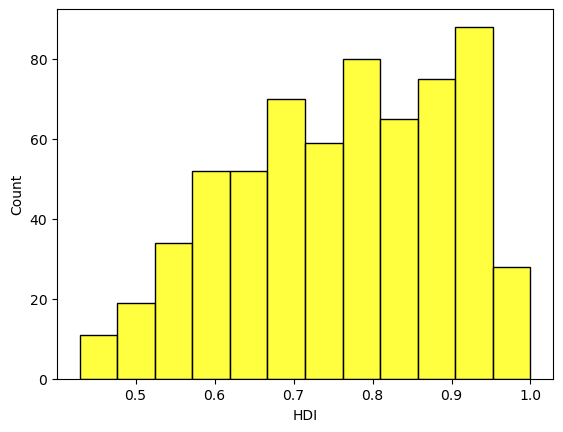

In [11]:
import seaborn as sea

sea.histplot(districts.HDI, color='yellow')

In [12]:
districts.explore(
    column="HDI",
    scheme="fisherjenks",
    legend=True,
    tooltip=False,
    popup=['State/Union', 'District'],  # show popup (on-click)
    legend_kwds=dict(colorbar=False)
)

In [13]:
!pip install libpysal

In [14]:
from libpysal.weights import Queen, Rook, KNN

# rook
w_rook = Rook.from_dataframe(districts,use_index=False)

C:\Users\mendo\anaconda3\envs\dataespacial__31111\Lib\site-packages\libpysal\weights\contiguity.py:61: UserWarning: The weights matrix is not fully connected: 
 There are 6 disconnected components.
 There are 4 islands with ids: 0, 1, 127, 282.
  W.__init__(self, neighbors, ids=ids, **kw)


In [15]:
w_rook.islands

[0, 1, 127, 282]

In [16]:
# queen
w_queen = Queen.from_dataframe(districts,use_index=False)

C:\Users\mendo\anaconda3\envs\dataespacial__31111\Lib\site-packages\libpysal\weights\contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 5 disconnected components.
 There are 3 islands with ids: 0, 1, 282.
  W.__init__(self, neighbors, ids=ids, **kw)


In [17]:
w_queen.islands

[0, 1, 282]

In [18]:
districts.iloc[w_queen.islands,:].explore()

In [19]:
# k=8 nearest neighbors
w_knn8 = KNN.from_dataframe(districts, k=8)

In [20]:
w_knn8.islands

[]

In [21]:
capital = districts[districts['District'] == 'West']
display(capital)

,State/Union,District,Wealth_Index_Above_2nd_Quintile,Secondary_School_Attendance,Prob_Survival_First5Yrs,HDI,geometry
126,NCT of Delhi,West,0.969,0.886,0.963,0.939,"MULTIPOLYGON (((3743007.249 4511991.338, 37428..."


In [22]:
# amount of neighbors of that district
len(w_rook.neighbors[126]),len(w_queen.neighbors[126])

(7, 7)

In [23]:
districts.iloc[w_rook.neighbors[126],]

,State/Union,District,Wealth_Index_Above_2nd_Quintile,Secondary_School_Attendance,Prob_Survival_First5Yrs,HDI,geometry
162,Haryana,Jhajjar,0.954,0.971,0.991,0.972,"MULTIPOLYGON (((3703135.5 4528351.619, 3703663..."
164,Haryana,Sonipat,0.940,0.937,0.965,0.947,"MULTIPOLYGON (((3679488.454 4577392.127, 36807..."
167,Haryana,Gurgaon,0.940,0.911,0.966,0.939,"MULTIPOLYGON (((3715858.418 4494004.054, 37166..."
539,Uttar Pradesh,Baghpat,0.824,0.814,0.951,0.861,"MULTIPOLYGON (((3725134.787 4557017.481, 37244..."
537,Uttar Pradesh,Ghaziabad,0.968,0.844,0.970,0.926,"MULTIPOLYGON (((3777001.971 4520467.486, 37758..."
538,Uttar Pradesh,Gautam Buddha Nagar,0.929,0.850,0.947,0.908,"MULTIPOLYGON (((3747063.972 4512105.936, 37474..."
171,Haryana,Faridabad,0.949,0.873,0.967,0.929,"MULTIPOLYGON (((3726361.466 4458097.746, 37271..."


<Axes: >

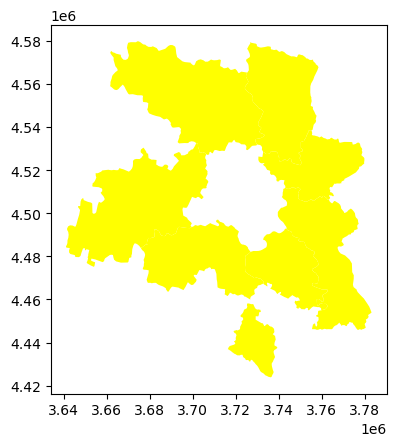

In [24]:
# see the neighbor
districts.iloc[w_rook.neighbors[126],].plot(facecolor="yellow")

<Axes: >

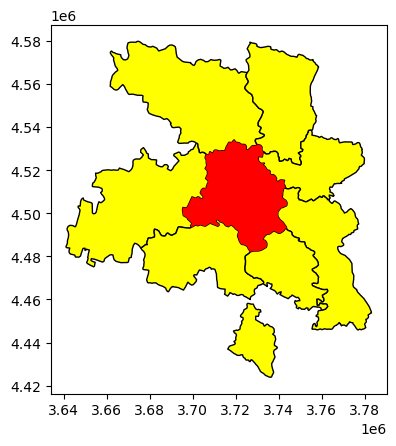

In [25]:
# see whole area
base=districts.iloc[w_rook.neighbors[126] ,].plot(facecolor="yellow",edgecolor='k')
districts.loc[districts.District=='West'].plot(ax=base,facecolor="red")

In [26]:
# details
districts.iloc[w_queen.neighbors[126],]

,State/Union,District,Wealth_Index_Above_2nd_Quintile,Secondary_School_Attendance,Prob_Survival_First5Yrs,HDI,geometry
162,Haryana,Jhajjar,0.954,0.971,0.991,0.972,"MULTIPOLYGON (((3703135.5 4528351.619, 3703663..."
164,Haryana,Sonipat,0.940,0.937,0.965,0.947,"MULTIPOLYGON (((3679488.454 4577392.127, 36807..."
167,Haryana,Gurgaon,0.940,0.911,0.966,0.939,"MULTIPOLYGON (((3715858.418 4494004.054, 37166..."
539,Uttar Pradesh,Baghpat,0.824,0.814,0.951,0.861,"MULTIPOLYGON (((3725134.787 4557017.481, 37244..."
537,Uttar Pradesh,Ghaziabad,0.968,0.844,0.970,0.926,"MULTIPOLYGON (((3777001.971 4520467.486, 37758..."
538,Uttar Pradesh,Gautam Buddha Nagar,0.929,0.850,0.947,0.908,"MULTIPOLYGON (((3747063.972 4512105.936, 37474..."
171,Haryana,Faridabad,0.949,0.873,0.967,0.929,"MULTIPOLYGON (((3726361.466 4458097.746, 37271..."


<Axes: >

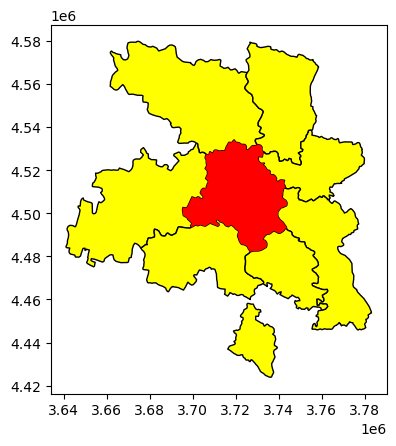

In [27]:
# whole area
# see whole area
base=districts.iloc[w_queen.neighbors[126] ,].plot(facecolor="yellow",edgecolor='k')
districts.loc[districts.District=='West'].plot(ax=base,facecolor="red")

In [28]:
w_knn8.neighbors[126]

[np.int64(167),
 np.int64(537),
 np.int64(162),
 np.int64(171),
 np.int64(539),
 np.int64(538),
 np.int64(164),
 np.int64(166)]

<Axes: >

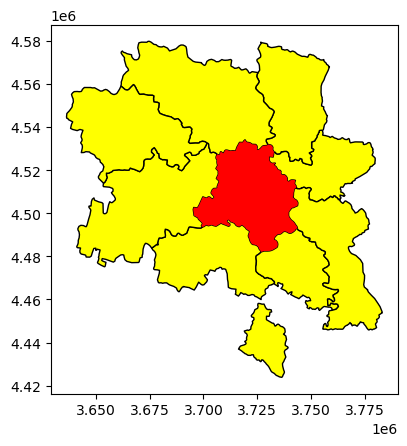

In [29]:
base=districts.iloc[w_knn8.neighbors[126] ,].plot(facecolor="yellow",edgecolor='k')
districts.loc[districts.District=='West'].plot(ax=base,facecolor="red")

Exercise 7

In [31]:
!pip install esda

In [32]:
pd.DataFrame(*w_knn8.full()) # 1 means both are neighbors

,0,1,2,3,4,5,6,7,8,9,...,623,624,625,626,627,628,629,630,631,632
0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
628,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
629,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
630,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
631,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [33]:
# needed for spatial correlation
w_knn8.transform = 'R'

In [34]:
# after transformation
pd.DataFrame(*w_knn8.full()).sum(axis=1)

0      1.0
1      1.0
2      1.0
3      1.0
4      1.0
      ... 
628    1.0
629    1.0
630    1.0
631    1.0
632    1.0
Length: 633, dtype: float64

In [35]:
from esda.moran import Moran

moranHDI = Moran(districts['HDI'], w_knn8)
moranHDI.I,moranHDI.p_sim

(np.float64(0.6434254521432141), np.float64(0.001))

In [36]:
!pip install splot

   ---------------------------------------- 0.0/6.3 MB ? eta -:--:--
   - -------------------------------------- 0.3/6.3 MB ? eta -:--:--
   ---- ----------------------------------- 0.8/6.3 MB 2.6 MB/s eta 0:00:03
   -------- ------------------------------- 1.3/6.3 MB 2.6 MB/s eta 0:00:02
   ----------- ---------------------------- 1.8/6.3 MB 2.5 MB/s eta 0:00:02
   ------------- -------------------------- 2.1/6.3 MB 2.4 MB/s eta 0:00:02
   ---------------- ----------------------- 2.6/6.3 MB 2.3 MB/s eta 0:00:02
   ---------------- ----------------------- 2.6/6.3 MB 2.3 MB/s eta 0:00:02
   ---------------- ----------------------- 2.6/6.3 MB 2.3 MB/s eta 0:00:02
   ------------------- -------------------- 3.1/6.3 MB 1.8 MB/s eta 0:00:02
   ------------------------ --------------- 3.9/6.3 MB 1.9 MB/s eta 0:00:02
   ---------------------------- ----------- 4.5/6.3 MB 2.1 MB/s eta 0:00:01
   ------------------------------- -------- 5.0/6.3 MB 2.1 MB/s eta 0:00:01
   -----------------------

Text(0, 0.5, 'SpatialLag_HDI_std')

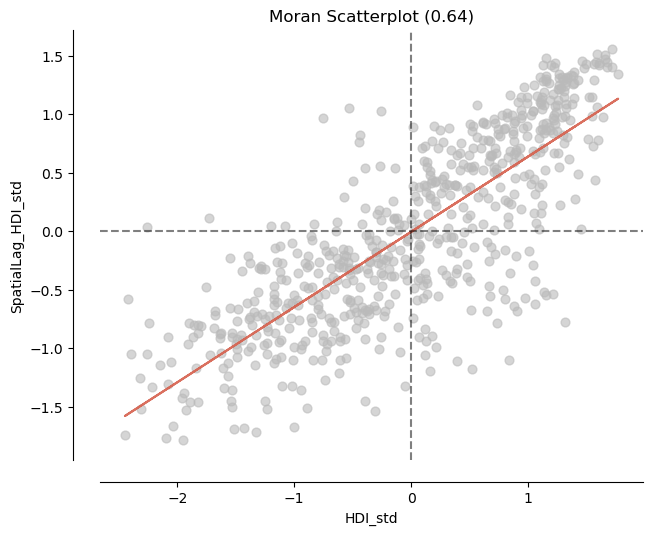

In [37]:
from splot.esda import moran_scatterplot

fig, ax = moran_scatterplot(moranHDI, aspect_equal=True)
ax.set_xlabel('HDI_std')
ax.set_ylabel('SpatialLag_HDI_std')

Text(0, 0.5, 'SpatialLag_HDI_std')

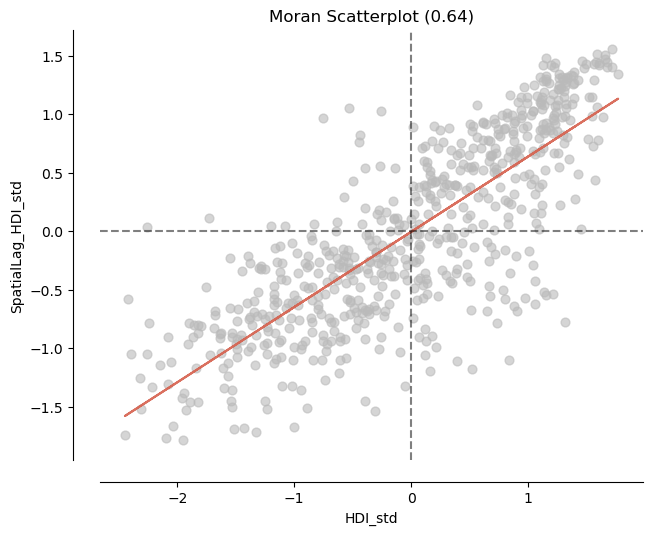

In [38]:
from splot.esda import moran_scatterplot

fig, ax = moran_scatterplot(moranHDI, aspect_equal=True)
ax.set_xlabel('HDI_std')
ax.set_ylabel('SpatialLag_HDI_std')

Text(0, 0.5, 'SpatialLag_SSA_std')

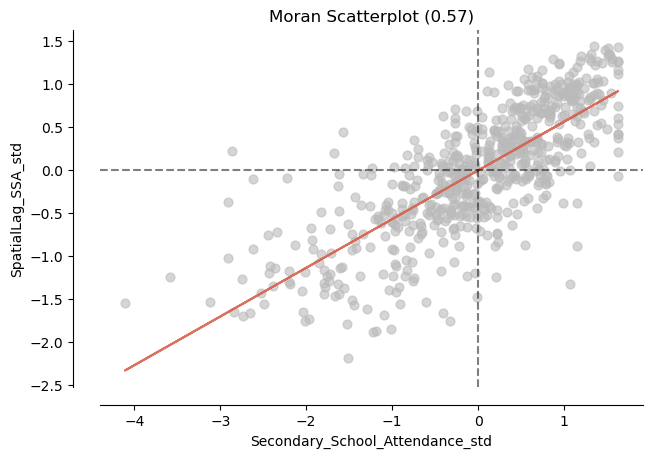

In [39]:
moranSSA = Moran(districts['Secondary_School_Attendance'], w_knn8)

fig, ax = moran_scatterplot(moranSSA, aspect_equal=True)
ax.set_xlabel('Secondary_School_Attendance_std')
ax.set_ylabel('SpatialLag_SSA_std')

Text(0, 0.5, 'SpatialLag_PSF_std')

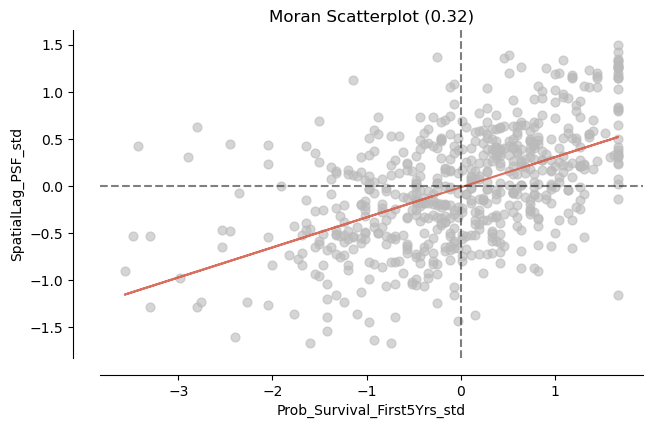

In [40]:
moranPSF = Moran(districts['Prob_Survival_First5Yrs'], w_knn8)

fig, ax = moran_scatterplot(moranPSF, aspect_equal=True)
ax.set_xlabel('Prob_Survival_First5Yrs_std')
ax.set_ylabel('SpatialLag_PSF_std')

Exercise 8

In [42]:
# A LISA for each district using IDH2019
from esda.moran import Moran_Local
lisaHDI = Moran_Local(y=districts['HDI'], w=w_knn8,seed=2022)

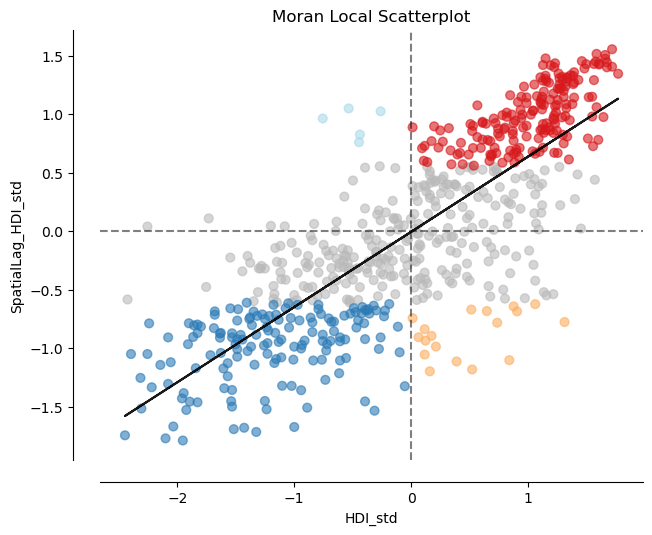

In [43]:
fig, ax = moran_scatterplot(lisaHDI,p=0.05)
ax.set_xlabel('HDI_std')
ax.set_ylabel('SpatialLag_HDI_std');

In [44]:
# quadrant, # significance
lisaHDI.q, lisaHDI.p_sim

(array([1, 1, 1, 1, 1, 4, 1, 1, 4, 4, 1, 1, 4, 1, 4, 4, 4, 4, 4, 4, 4, 4,
        3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
        3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3,
        3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
        3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 4, 1, 1, 1, 4, 3, 2, 2, 3, 2,
        3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 4, 4, 1, 4, 1, 1, 1, 4, 1, 1, 1, 1, 4, 1, 4, 3, 2, 3, 2,
        2, 3, 2, 3, 3, 3, 3, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 2, 4, 1, 1, 1, 1, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 4, 4, 4, 4,
        3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 3, 3,
        3, 3, 2, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4,
        4, 4, 4, 1, 4, 1, 2, 3, 2, 2, 

In [45]:
# quadrant: 1 HH,  2 LH,  3 LL,  4 HL
pd.Series(lisaHDI.q).value_counts()

1    263
3    263
4     76
2     31
Name: count, dtype: int64

In [46]:
districts['HDI_quadrant']=[l if p <0.05 else 0 for l,p in zip(lisaHDI.q,lisaHDI.p_sim)  ]
districts['HDI_quadrant'].value_counts()

HDI_quadrant
0    279
1    180
3    151
4     18
2      5
Name: count, dtype: int64

In [47]:
labels = [ '0 no_sig', '1 hotSpot', '2 coldOutlier', '3 coldSpot', '4 hotOutlier']

districts['HDI_quadrant_names']=[labels[i] for i in districts['HDI_quadrant']]

districts['HDI_quadrant_names'].value_counts()

HDI_quadrant_names
0 no_sig         279
1 hotSpot        180
3 coldSpot       151
4 hotOutlier      18
2 coldOutlier      5
Name: count, dtype: int64

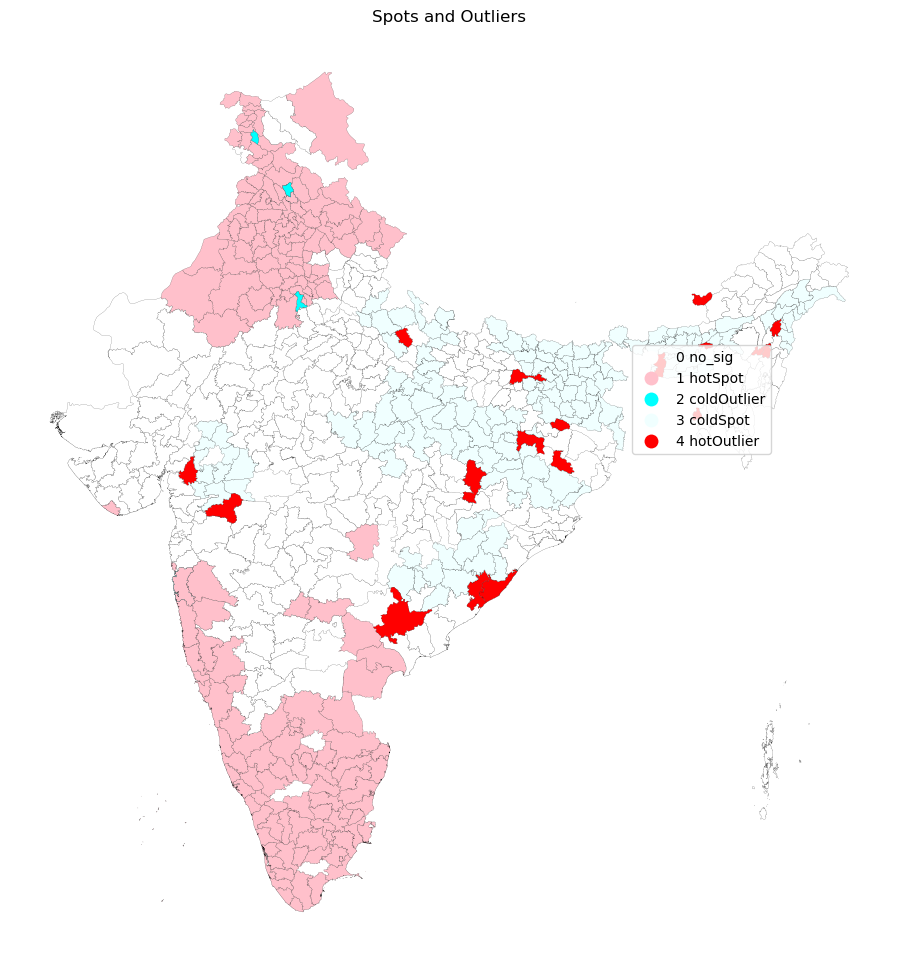

In [48]:
# custom colors
import matplotlib.pyplot as plt
from matplotlib import colors
myColMap = colors.ListedColormap([ 'white', 'pink', 'cyan', 'azure','red'])

# Set up figure and ax
f, ax = plt.subplots(1, figsize=(12,12))
# Plot unique values choropleth including
# a legend and with no boundary lines

plt.title('Spots and Outliers')

districts.plot(column='HDI_quadrant_names',
                categorical=True,
                cmap=myColMap,
                linewidth=0.1,
                edgecolor='k',
                legend=True,
                legend_kwds={'loc': 'center left',
                             'bbox_to_anchor': (0.7, 0.6)},
                ax=ax)
# Remove axis
ax.set_axis_off()
# Display the map
plt.show()

In [49]:
from esda.moran import Moran_Local
lisaSSA = Moran_Local(y=districts['Secondary_School_Attendance'], w=w_knn8,seed=2022)

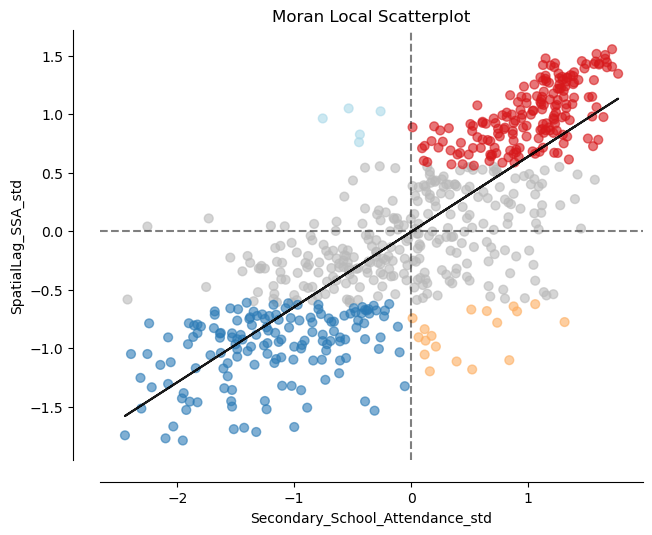

In [50]:
fig, ax = moran_scatterplot(lisaHDI,p=0.05)
ax.set_xlabel('Secondary_School_Attendance_std')
ax.set_ylabel('SpatialLag_SSA_std');

In [51]:
# quadrant, # significance
lisaSSA.q, lisaSSA.p_sim

(array([1, 1, 4, 1, 1, 4, 1, 2, 4, 4, 1, 2, 4, 2, 4, 1, 1, 1, 1, 1, 1, 2,
        1, 1, 4, 3, 1, 1, 1, 2, 2, 3, 4, 1, 3, 4, 2, 1, 3, 1, 1, 3, 4, 1,
        3, 1, 2, 2, 1, 2, 3, 4, 3, 2, 1, 3, 3, 2, 2, 3, 1, 3, 1, 2, 3, 4,
        3, 1, 1, 3, 4, 4, 3, 3, 3, 4, 3, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3,
        3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 3, 2, 2, 4, 1,
        4, 2, 2, 4, 4, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 1, 1, 3,
        3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
        3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 4, 2, 4, 1, 1, 1, 1, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4, 1,
        1, 1, 4, 3, 4, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 4, 3, 3,
        3, 3, 2, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 3,
        3, 2, 4, 3, 3, 3, 3, 3, 3, 3, 

In [52]:
# quadrant: 1 HH,  2 LH,  3 LL,  4 HL
pd.Series(lisaSSA.q).value_counts()

1    273
3    231
4     73
2     56
Name: count, dtype: int64

In [53]:
districts['SSA_quadrant']=[l if p <0.05 else 0 for l,p in zip(lisaSSA.q,lisaSSA.p_sim)  ]
districts['SSA_quadrant'].value_counts()

SSA_quadrant
0    355
1    153
3    109
4     11
2      5
Name: count, dtype: int64

In [54]:
labels = [ '0 no_sig', '1 hotSpot', '2 coldOutlier', '3 coldSpot', '4 hotOutlier']

districts['SSA_quadrant_names']=[labels[i] for i in districts['SSA_quadrant']]

districts['SSA_quadrant_names'].value_counts()

SSA_quadrant_names
0 no_sig         355
1 hotSpot        153
3 coldSpot       109
4 hotOutlier      11
2 coldOutlier      5
Name: count, dtype: int64

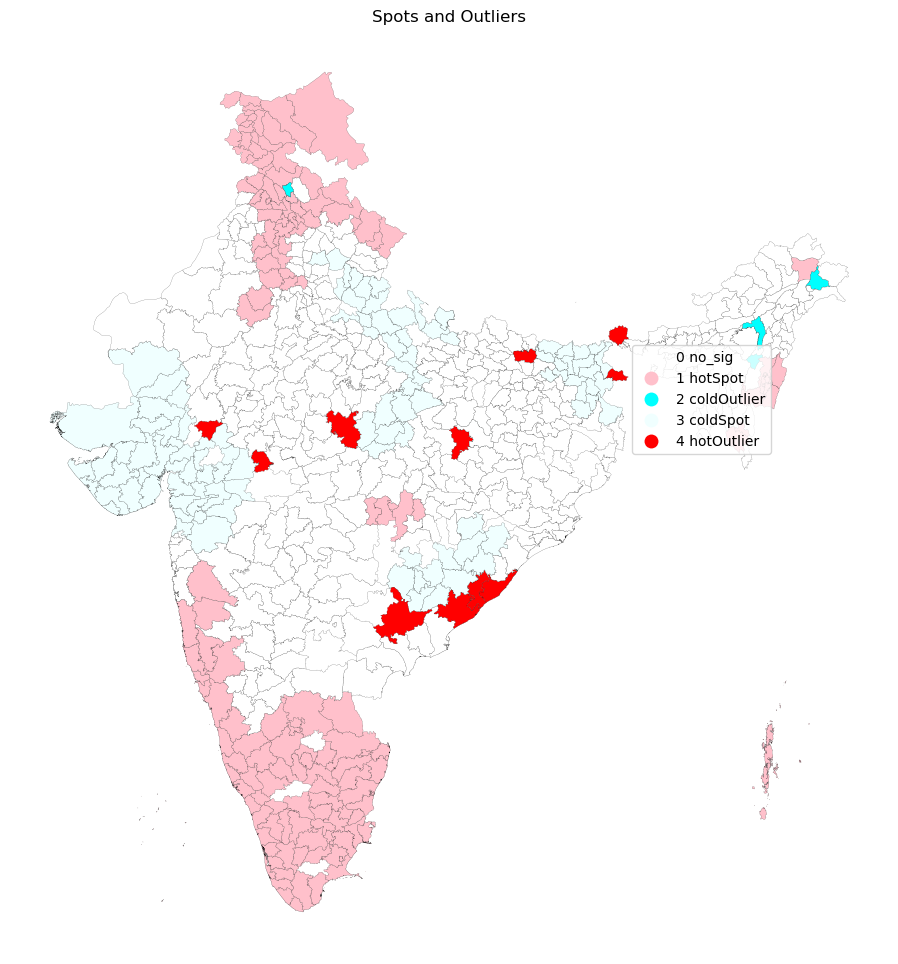

In [55]:
# custom colors
import matplotlib.pyplot as plt
from matplotlib import colors
myColMap = colors.ListedColormap([ 'white', 'pink', 'cyan', 'azure','red'])

# Set up figure and ax
f, ax = plt.subplots(1, figsize=(12,12))
# Plot unique values choropleth including
# a legend and with no boundary lines

plt.title('Spots and Outliers')

districts.plot(column='SSA_quadrant_names',
                categorical=True,
                cmap=myColMap,
                linewidth=0.1,
                edgecolor='k',
                legend=True,
                legend_kwds={'loc': 'center left',
                             'bbox_to_anchor': (0.7, 0.6)},
                ax=ax)
# Remove axis
ax.set_axis_off()
# Display the map
plt.show()

Exercise 9

In [57]:
selected_variables = ['Wealth_Index_Above_2nd_Quintile',
                     'Secondary_School_Attendance',
                     'Prob_Survival_First5Yrs']

<Axes: >

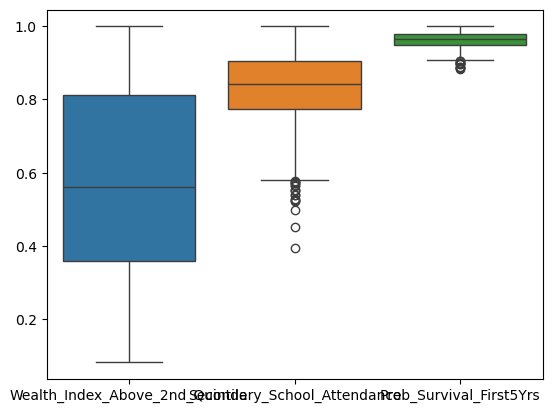

In [58]:
# see distribution
sea.boxplot(districts[selected_variables])

In [59]:
districts[selected_variables].corr()

,Wealth_Index_Above_2nd_Quintile,Secondary_School_Attendance,Prob_Survival_First5Yrs
Wealth_Index_Above_2nd_Quintile,1.000000,0.485996,0.396964
Secondary_School_Attendance,0.485996,1.000000,0.454648
Prob_Survival_First5Yrs,0.396964,0.454648,1.000000


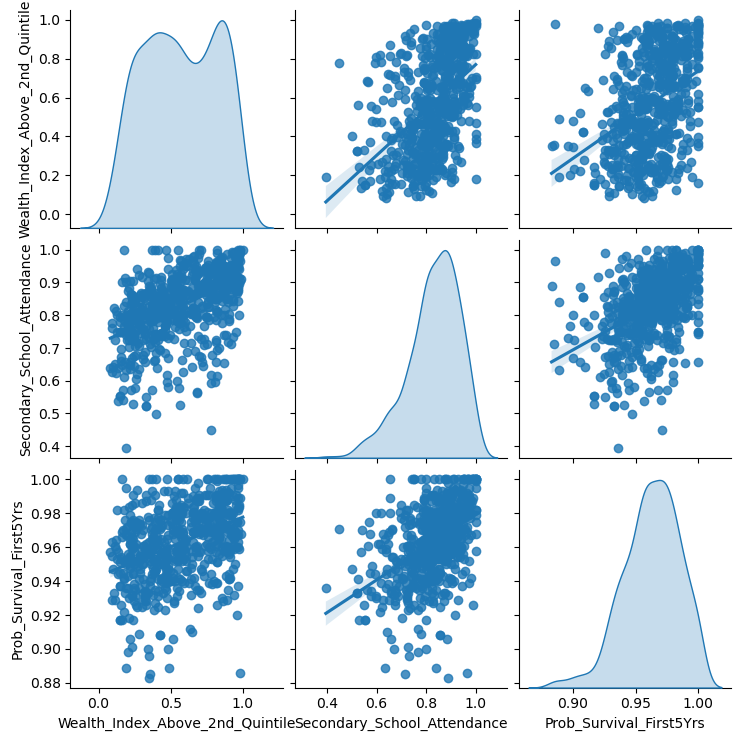

In [60]:
sea.pairplot(
    districts[selected_variables], kind="reg", diag_kind="kde"
)

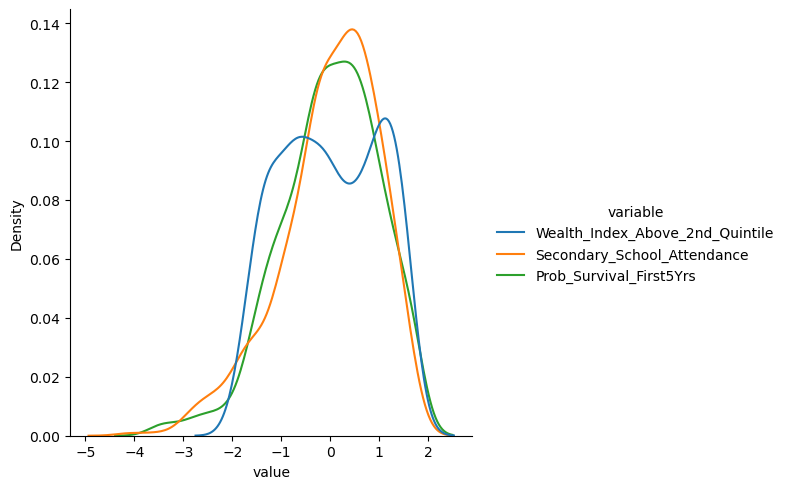

In [61]:
from sklearn.preprocessing import StandardScaler


scaler = StandardScaler()
normalized_data = scaler.fit_transform(districts[selected_variables])
sea.displot(pd.melt(pd.DataFrame(normalized_data,columns=selected_variables)),
            x="value", hue="variable",kind="kde",
            log_scale=(False,False))

In [62]:
# new names
selected_variables_new_std=[s+'_std' for s in selected_variables]

# add colunms
districts[selected_variables_new_std]=normalized_data

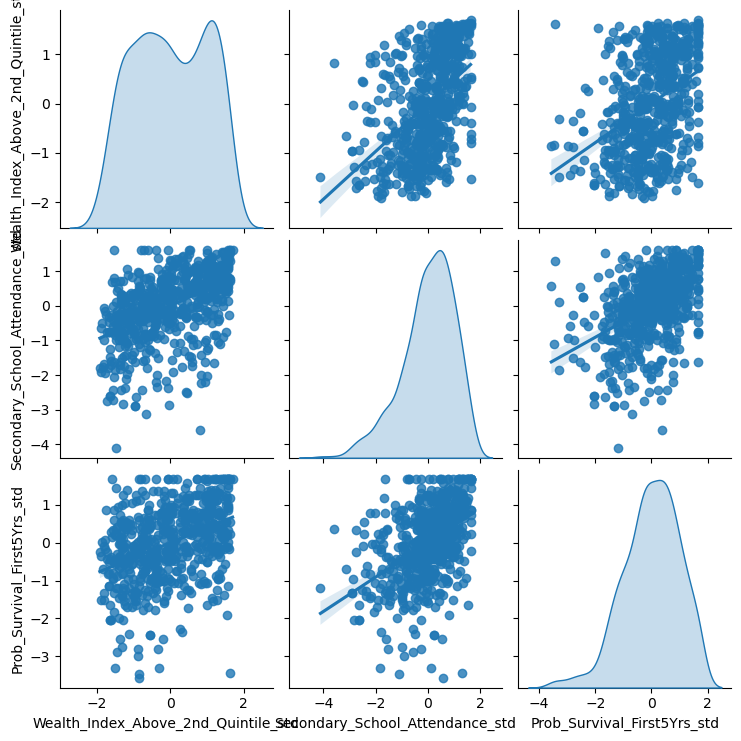

In [63]:
# as a result:
selected_variables_new_std = ['Wealth_Index_Above_2nd_Quintile_std',
                     'Secondary_School_Attendance_std',
                     'Prob_Survival_First5Yrs_std']
sea.pairplot(
    districts[selected_variables_new_std], kind="reg", diag_kind="kde"
)

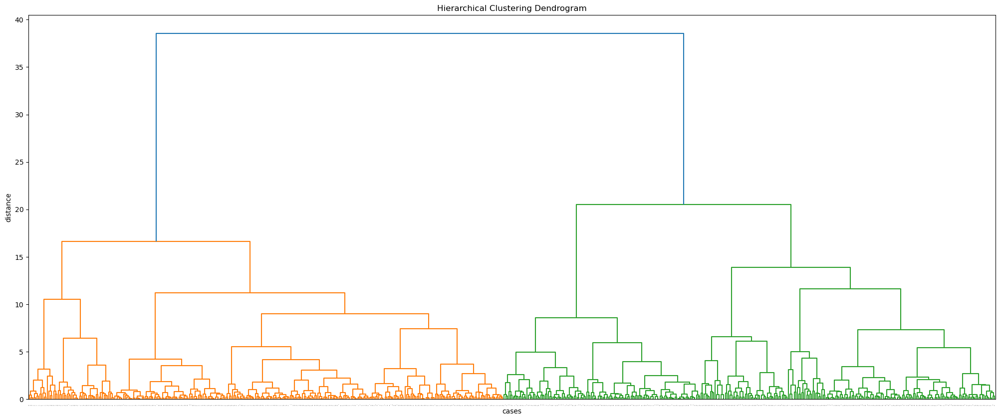

In [64]:
from scipy.cluster import hierarchy as hc

Z = hc.linkage(districts[selected_variables_new_std], 'ward')
# calculate full dendrogram
plt.figure(figsize=(25, 10))
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('cases')
plt.ylabel('distance')
hc.dendrogram(
    Z,
    leaf_rotation=90.,  # rotates the x axis labels
    leaf_font_size=1,  # font size for the x axis labels
)
plt.show()

In [65]:
from sklearn.cluster import AgglomerativeClustering as agnes

import numpy as np
np.random.seed(12345)# Set seed for reproducibility

# Initialize the algorithm, requesting 6 clusters
model = agnes(linkage="ward", n_clusters=6).fit(districts[selected_variables_new_std])

# Assign labels to main data table
districts["hc_ag6"] = model.labels_

In [66]:
# see distribution of districts
districts["hc_ag6"].value_counts()

hc_ag6
0    255
2    129
3    111
4     57
1     56
5     25
Name: count, dtype: int64

In [67]:
districts.groupby("hc_ag6")[selected_variables_new_std].mean()

,Wealth_Index_Above_2nd_Quintile_std,Secondary_School_Attendance_std,Prob_Survival_First5Yrs_std
hc_ag6,,,
0,0.810192,0.760727,0.678130
1,0.992289,-0.642456,-0.326209
2,-0.657353,0.066438,0.320661
3,-0.875546,-0.376034,-0.707919
4,-1.161041,-1.928298,-0.968072
5,-0.560150,-0.597021,-2.490463


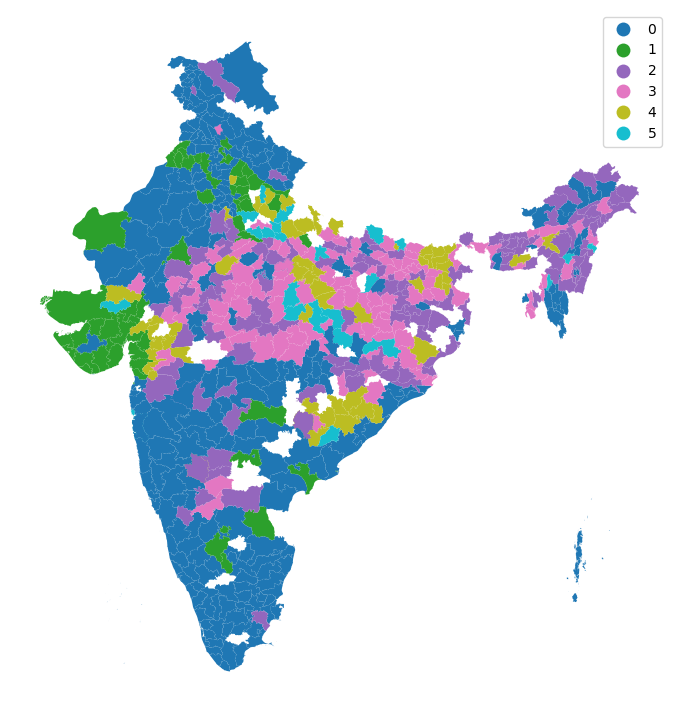

In [68]:
# Set up figure and ax
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot unique values choropleth including
# a legend and with no boundary lines
districts.plot(
    column="hc_ag6", categorical=True, legend=True, linewidth=0, ax=ax
)
# Remove axis
ax.set_axis_off()
# Display the map
plt.show()

In [69]:
# modify previous funtion call to specify cluster model with spatial constraint

model_queen = agnes(linkage="ward",
                    n_clusters=6,
                    connectivity=w_queen.sparse).fit(districts[selected_variables_new_std])
# Fit algorithm to the data
districts["hc_ag6_wQueen"] = model_queen.labels_

C:\Users\mendo\anaconda3\envs\dataespacial__31111\Lib\site-packages\sklearn\cluster\_agglomerative.py:325: UserWarning: the number of connected components of the connectivity matrix is 5 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


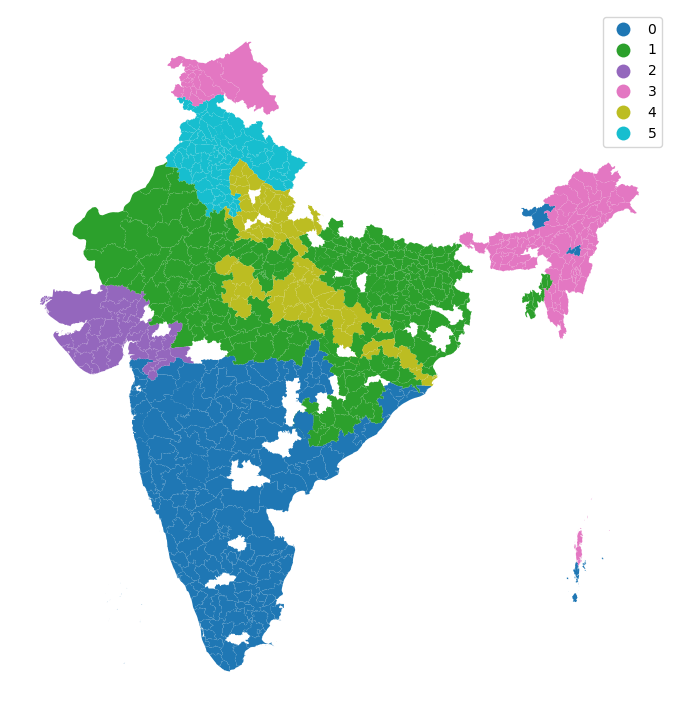

In [70]:
# Set up figure and ax
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot unique values choropleth including a legend and with no boundary lines
districts.plot(
    column="hc_ag6_wQueen",
    categorical=True,
    legend=True,
    linewidth=0,
    ax=ax,
)
# Remove axis
ax.set_axis_off()
# Display the map
plt.show()

In [71]:
model_wknn8 = agnes(linkage="ward",
                    n_clusters=6,
                    connectivity=w_knn8.sparse).fit(districts[selected_variables_new_std])
districts["hc_ag6_wknn8"] = model_wknn8.labels_

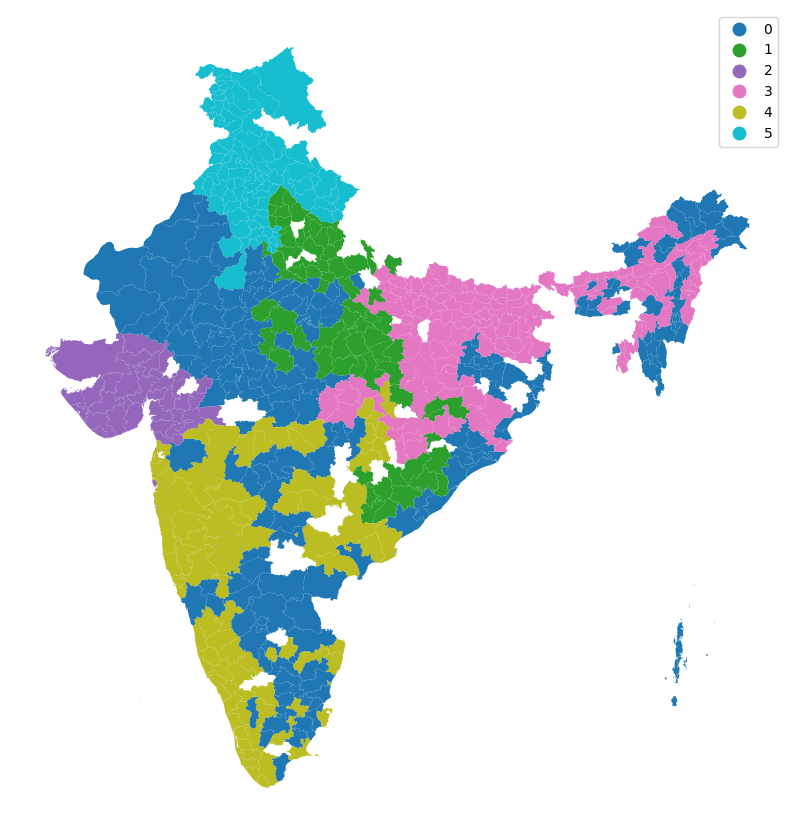

In [72]:
# Set up figure and ax
f, ax = plt.subplots(1, figsize=(10, 12))
# Plot unique values choropleth including a legend and with no boundary lines
districts.plot(
    column="hc_ag6_wknn8",
    categorical=True,
    legend=True,
    linewidth=0,
    ax=ax,
)
# Remove axis
ax.set_axis_off()
# Display the map
plt.show()

In [73]:
from esda import shape as shapestats
results={}
for cluster_type in ("hc_ag6_wknn8", "hc_ag6"):
    # compute the region polygons using a dissolve
    regions = districts[[cluster_type, "geometry"]].to_crs(7755).dissolve(by=cluster_type)
    # compute the actual isoperimetric quotient for these regions
    ipqs = shapestats.isoperimetric_quotient(regions)
    # cast to a dataframe
    result = {cluster_type:ipqs}
    results.update(result)
# stack the series together along columns
pd.DataFrame(results)

,hc_ag6_wknn8,hc_ag6
0,0.006588,0.005475
1,0.015873,0.008415
2,0.028184,0.003860
3,0.011220,0.004861
4,0.010901,0.009011
5,0.044095,0.013651


In [74]:
from esda import shape as shapestats
results={}
for cluster_type in ("hc_ag6_wknn8", "hc_ag6"):
    # compute the region polygons using a dissolve
    regions = districts[[cluster_type, "geometry"]].to_crs(7755).dissolve(by=cluster_type)
    # compute the actual convex hull quotient for these regions
    chullr = shapestats.convex_hull_ratio(regions)
    # cast to a dataframe
    result = {cluster_type:chullr}
    results.update(result)
# stack the series together along columns
pd.DataFrame(results)

,hc_ag6_wknn8,hc_ag6
0,0.207758,0.202565
1,0.423602,0.157215
2,0.586189,0.147140
3,0.427325,0.172362
4,0.360999,0.115156
5,0.628876,0.056561


In [75]:
from sklearn import metrics

fit_scores = []
for cluster_type in ("hc_ag6_wknn8", "hc_ag6"):
    # compute the CH score
    ch_score = metrics.calinski_harabasz_score(
        # using scaled variables
        districts[selected_variables_new_std],
        # using these labels
        districts[cluster_type],
    )
    sil_score = metrics.silhouette_score(
        # using scaled variables
        districts[selected_variables_new_std],
        # using these labels
        districts[cluster_type],
    )
    # and append the cluster type with the CH score
    fit_scores.append((cluster_type, ch_score,sil_score))


# re-arrange the scores into a dataframe for display
pd.DataFrame(
    fit_scores, columns=["cluster type", "CH score", "SIL score"]
).set_index("cluster type")

,CH score,SIL score
cluster type,,
hc_ag6_wknn8,126.443557,0.042646
hc_ag6,245.201020,0.249418


Exercise 10

In [87]:
!pip install pysal

  Using cached pysal-25.1-py3-none-any.whl.metadata (15 kB)
  Using cached access-1.1.9-py3-none-any.whl.metadata (2.4 kB)
  Using cached inequality-1.1.1-py3-none-any.whl.metadata (3.9 kB)
  Using cached pointpats-2.5.1-py3-none-any.whl.metadata (4.7 kB)
  Using cached segregation-2.5.2-py3-none-any.whl.metadata (2.2 kB)
  Using cached spaghetti-1.7.6-py3-none-any.whl.metadata (12 kB)
  Using cached mgwr-2.2.1-py3-none-any.whl.metadata (1.5 kB)
  Using cached momepy-0.10.0-py3-none-any.whl.metadata (1.5 kB)
  Using cached spglm-1.1.0-py3-none-any.whl.metadata (3.9 kB)
  Using cached spint-1.0.7.tar.gz (28 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Using cached tobler-0.12.1-py3-none-any.whl.metadata (1.9 kB)
  Using cached spopt-0.6.1-py3-none-any.whl.metadata (10 kB)
  Using cached tqdm-4.67.1-py3-none-any.whl.metadata (57 kB)
  Using cached deprecation-2.1.0-py2.py3-none-any.whl.metadata (4.6 kB)
  Using cached rtree-1

In [89]:
from pysal.model import spreg

dep_var_name=['Wealth_Index_Above_2nd_Quintile']
ind_vars_names=['Secondary_School_Attendance','Prob_Survival_First5Yrs']
labels=['Wealth Index Above 2nd Quintile %','Secondary-School Attendance %', 'Probability of Survival in the First 5Yrs %']

ols_model = spreg.OLS(
    # Dependent variable
    districts[dep_var_name].values,
    # Independent variables
    districts[ind_vars_names].values,
    # Dependent variable name
    name_y=labels[0],
    # Independent variable name
    name_x=labels[1:],
    name_ds='districts')

print(ols_model.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :   districts
Weights matrix      :        None
Dependent Variable  :Wealth Index Above 2nd Quintile %                Number of Observations:         633
Mean dependent var  :      0.5690                Number of Variables   :           3
S.D. dependent var  :      0.2539                Degrees of Freedom    :         630
R-squared           :      0.2752
Adjusted R-squared  :      0.2729
Sum squared residual:     29.5313                F-statistic           :    119.6281
Sigma-square        :       0.047                Prob(F-statistic)     :   9.135e-45
S.E. of regression  :       0.217                Log likelihood        :      71.891
Sigma-square ML     :       0.047                Akaike info criterion :    -137.781
S.E of regression ML:      0.2160                Schwarz criterion     :    -124.430

---------------------------------------

In [91]:
# the dependent variable
moranWI = Moran(districts[dep_var_name], w_knn8)
moranWI.I,moranWI.p_sim

(np.float64(0.6755988730591118), np.float64(0.001))

In [93]:
# the error term
moranError = Moran(ols_model.u, w_knn8)
moranError.I,moranError.p_sim

(np.float64(0.6669397918119403), np.float64(0.001))

In [95]:
SAC_model = spreg.ML_Lag(
    # Dependent variable
    districts[dep_var_name].values,
    # Independent variables
    districts[ind_vars_names].values,
    w=w_knn8,
    # Dependent variable name
    name_y=labels[0],
    # Independent variable name
    name_x=labels[1:],
    name_w='KNN8',
    name_ds='districts'
    )

print(SAC_model.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: MAXIMUM LIKELIHOOD SPATIAL LAG (METHOD = FULL)
-----------------------------------------------------------------
Data set            :   districts
Weights matrix      :        KNN8
Dependent Variable  :Wealth Index Above 2nd Quintile %                Number of Observations:         633
Mean dependent var  :      0.5690                Number of Variables   :           4
S.D. dependent var  :      0.2539                Degrees of Freedom    :         629
Pseudo R-squared    :      0.7186
Spatial Pseudo R-squared:  0.2557
Log likelihood      :    334.9282
Sigma-square ML     :      0.0183                Akaike info criterion :    -661.856
S.E of regression   :      0.1353                Schwarz criterion     :    -644.055

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------

In [97]:
SER_model = spreg.ML_Error(
    # Dependent variable
    districts[dep_var_name].values,
    # Independent variables
    districts[ind_vars_names].values,
    w=w_knn8,
    # Dependent variable name
    name_y=labels[0],
    # Independent variable name
    name_x=labels[1:],
    name_w='KNN8',
    name_ds='districts'
    )

print(SER_model.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ML SPATIAL ERROR (METHOD = full)
---------------------------------------------------
Data set            :   districts
Weights matrix      :        KNN8
Dependent Variable  :Wealth Index Above 2nd Quintile %                Number of Observations:         633
Mean dependent var  :      0.5690                Number of Variables   :           3
S.D. dependent var  :      0.2539                Degrees of Freedom    :         630
Pseudo R-squared    :      0.2750
Log likelihood      :    361.6024
Sigma-square ML     :      0.0163                Akaike info criterion :    -717.205
S.E of regression   :      0.1277                Schwarz criterion     :    -703.853

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTAN

C:\Users\mendo\anaconda3\envs\dataespacial__31111\Lib\site-packages\spreg\ml_error.py:184: RuntimeWarning: Method 'bounded' does not support relative tolerance in x; defaulting to absolute tolerance.
  res = minimize_scalar(


In [99]:
SAC_model = spreg.GM_Combo_Het(
    # Dependent variable
    districts[dep_var_name].values,
    # Independent variables
    districts[ind_vars_names].values,
    w=w_knn8,
    # Dependent variable name
    name_y=labels[0],
    # Independent variable name
    name_x=labels[1:],
    name_w='KNN8',
    name_ds='districts'
)

# Print results
print(SAC_model.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: SPATIALLY WEIGHTED 2SLS- GM-COMBO MODEL (HET)
----------------------------------------------------------------
Data set            :   districts
Weights matrix      :        KNN8
Dependent Variable  :Wealth Index Above 2nd Quintile %                Number of Observations:         633
Mean dependent var  :      0.5690                Number of Variables   :           4
S.D. dependent var  :      0.2539                Degrees of Freedom    :         629
Pseudo R-squared    :      0.5238
Spatial Pseudo R-squared:  0.2829
N. of iterations    :           1                Step1c computed       :          No

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT        -2.19490         0.28020        -7.83320         0